In [18]:
# Import Libraries
import torch
from roboflow import Roboflow

In [9]:
# Load Original Model
model = torch.hub.load("ultralytics/yolov5", "yolov5s")

# Images
img = "../images/Image.jpeg"  # or file, Path, PIL, OpenCV, numpy, list

# Inference
results = model(img)

Using cache found in /Users/samdenlepcha/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-3-3 Python-3.11.7 torch-2.2.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


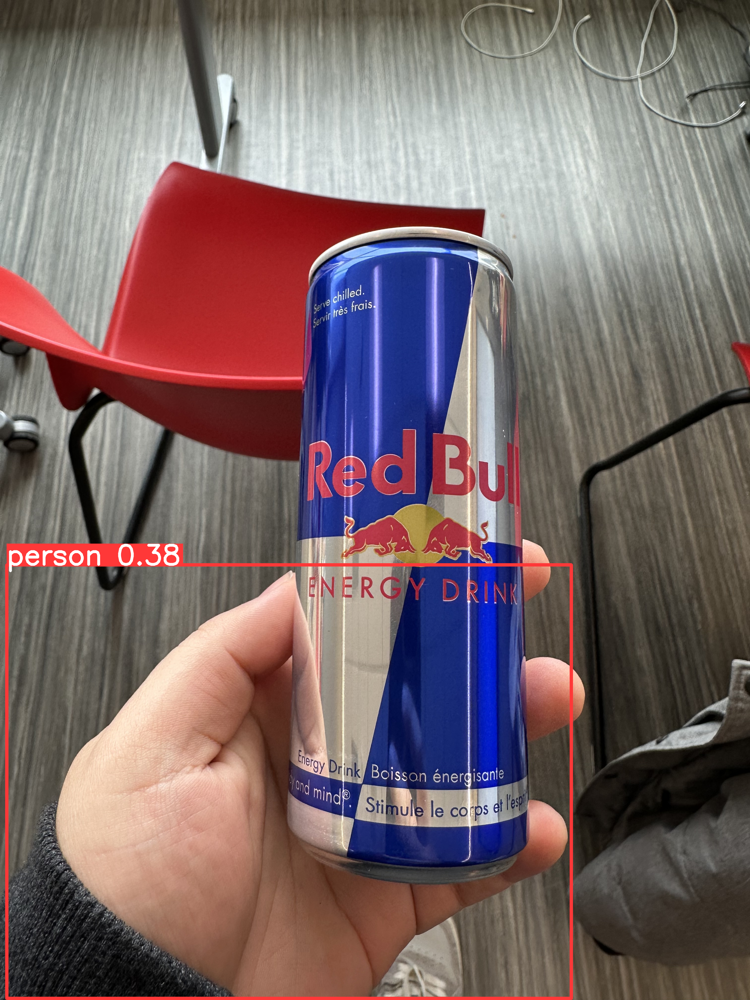

In [10]:
# View Results
results.show()

## Load Custom Model

In [11]:
model = torch.hub.load('../yolov5', 'custom', path='../yolov5/runs/train/exp8/weights/best.pt', source='local', force_reload=True)

YOLOv5 🚀 2024-3-3 Python-3.11.7 torch-2.2.1 CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


In [12]:
# Images
img = "../images/Image.jpeg"  # or file, Path, PIL, OpenCV, numpy, list

# Inference
results = model(img)

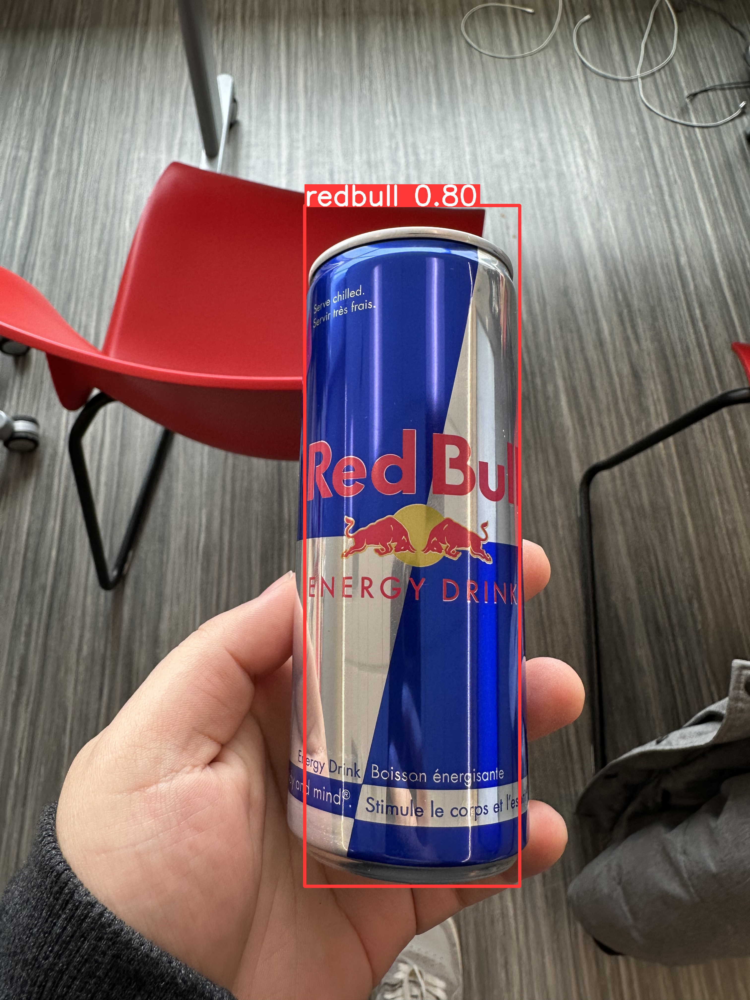

In [13]:
results.show()

In [8]:
!python ../yolov5/detect.py --weights ../yolov5/runs/train/exp7/weights/best.pt --img 640 --conf 0.25 --source ../images/test/redbull.jpg

detect: weights=['../yolov5/runs/train/exp7/weights/best.pt'], source=../images/test/redbull.jpg, data=../yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=../yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-288-gb9392361 Python-3.11.7 torch-2.2.1 CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /Users/samdenlepcha/Desktop/Projects/Hackathon/images/test/redbull.jpg: 640x640 (no detections), 182.6ms
Speed: 0.8ms pre-process, 182.6ms inference, 0.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to ../yolov5/runs/detect/exp7


## QR Code Scanner

In [14]:
from pyzbar.pyzbar import decode
from PIL import Image

In [15]:
def scan_barcode(image_path):
    # Load the image
    image = Image.open(image_path)
    
    # Decode all barcodes/QR codes in the image
    decoded_objects = decode(image)
    
    # If no objects found, print that no QR/Barcodes were found
    if not decoded_objects:
        print("No QR/Barcodes found.")
        return
    
    # Print the type and data of each barcode/QR code found
    for obj in decoded_objects:

        data = obj.data.decode('utf-8')

        print(f"Type: {obj.type}")
        print(f"Data: {data}\n")

    return data

In [16]:
# Example usage
image_path = '../images/Chips.jpg'
barcode_num = scan_barcode(image_path)

Type: EAN13
Data: 0059119353347



### Load Cloud Based Model(Trained)

In [19]:
# Call RoboFlow Custom Trained Model Through API KEY
rf = Roboflow(api_key="gA7hteJoQAVdxkPIEE2v")
project = rf.workspace().project("sustain")
model = project.version(2).model

loading Roboflow workspace...
loading Roboflow project...


In [ ]:
# Predictions
model_output = model.predict("../images/test/redbull.jpg", confidence=60, overlap=60)
model_predictions = model_output.json()

# Save Predictions
model_output.save("prediction.jpg")

In [ ]:
# Calculate Scores
score = 0

# Changes based on number of classes
points = {'redbull':50}
for prediction in model_predictions['predictions']:
    score += points[prediction['class']]

print("Your Current Score = ",score)